<a href="https://colab.research.google.com/github/Tejaswini0615/Machine-Vision-Lab/blob/main/LAB3_22BAI1152_L49%2B50.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

https://chatgpt.com/share/67923e5c-0e0c-8003-8282-8f328a473106

QUESTION 1 A): WITH COLOR AND GRAYSCALE IMAGE

Kernel Size: (3, 3), PSNR: 27.24, SSIM: 0.8506


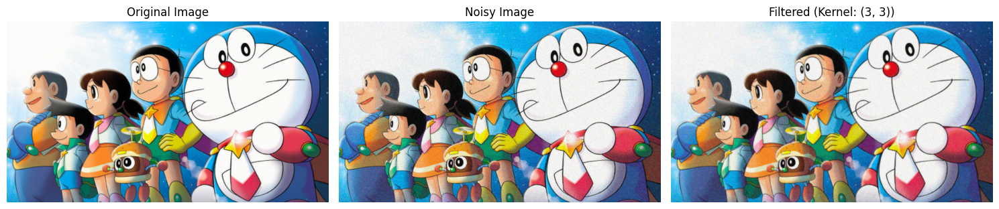

Kernel Size: (5, 5), PSNR: 26.18, SSIM: 0.8970


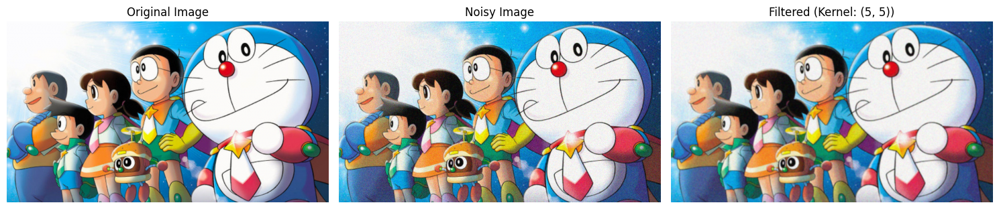

Kernel Size: (7, 7), PSNR: 24.48, SSIM: 0.8991


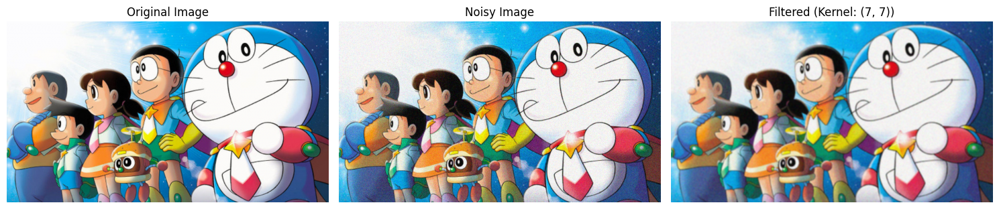

Kernel Size: (3, 5), PSNR: 26.82, SSIM: 0.8796


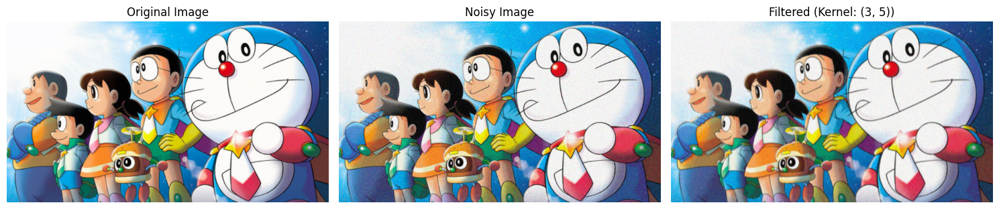

Kernel Size: (3, 3), PSNR: 24.43, SSIM: 0.8262


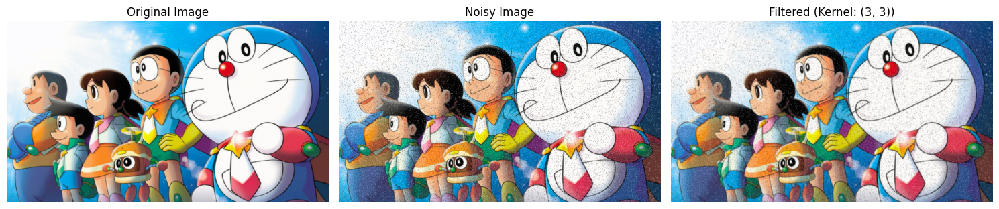

Kernel Size: (5, 5), PSNR: 25.04, SSIM: 0.8724


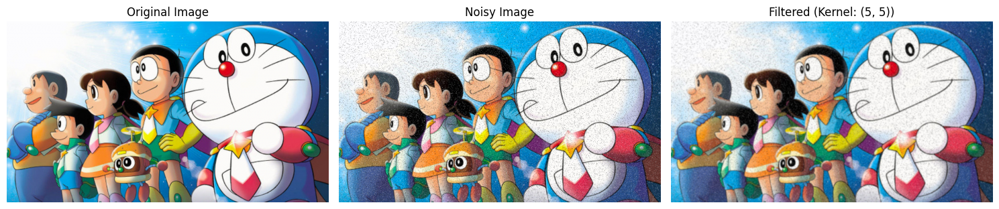

Kernel Size: (7, 7), PSNR: 23.97, SSIM: 0.8898


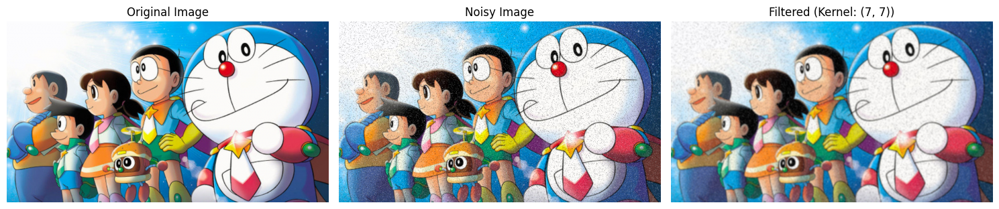

Kernel Size: (3, 5), PSNR: 24.98, SSIM: 0.8448


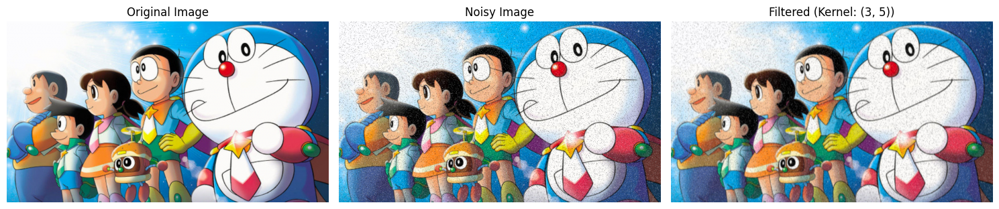

In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
from skimage.metrics import peak_signal_noise_ratio as psnr, structural_similarity as ssim

# Load an image (color or grayscale)
image = cv2.imread('image.jpg')  # Replace 'image.jpg' with your image path
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB

# Function to add Gaussian noise
def add_gaussian_noise(img, mean=0, var=0.01):
    sigma = var**0.5
    gauss = np.random.normal(mean, sigma, img.shape)
    noisy = img + gauss
    return np.clip(noisy, 0, 1)

# Function to add salt-and-pepper noise
def add_salt_and_pepper_noise(img, salt_prob=0.01, pepper_prob=0.01):
    noisy = np.copy(img)
    total_pixels = img.size
    num_salt = np.ceil(salt_prob * total_pixels)
    num_pepper = np.ceil(pepper_prob * total_pixels)

    # Add salt
    coords = [np.random.randint(0, i - 1, int(num_salt)) for i in img.shape]
    noisy[coords[0], coords[1], :] = 1

    # Add pepper
    coords = [np.random.randint(0, i - 1, int(num_pepper)) for i in img.shape]
    noisy[coords[0], coords[1], :] = 0

    return noisy

# Normalize the image
image = image / 255.0

# Add noises
gaussian_noisy_image = add_gaussian_noise(image)
sp_noisy_image = add_salt_and_pepper_noise(image)

# Define kernel sizes
kernel_sizes = [(3, 3), (5, 5), (7, 7), (3, 5)]

# Function to apply moving average filter
def apply_moving_average_filter(img, kernel_size):
    return cv2.blur(img, kernel_size)

# Plotting function
def plot_images(original, noisy, filtered_images, titles):
    plt.figure(figsize=(15, 10))
    plt.subplot(2, 3, 1)
    plt.imshow(original)
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(2, 3, 2)
    plt.imshow(noisy)
    plt.title('Noisy Image')
    plt.axis('off')

    for i, (filtered, title) in enumerate(zip(filtered_images, titles)):
        plt.subplot(2, 3, i + 3)
        plt.imshow(filtered)
        plt.title(title)
        plt.axis('off')

    plt.tight_layout()
    plt.show()
# Process and display results for Gaussian noise
for kernel_size in kernel_sizes:
    filtered_image = apply_moving_average_filter(gaussian_noisy_image, kernel_size)
    psnr_value = psnr(image, filtered_image)
    # Explicitly set win_size to a smaller odd value like 3
    # Specify data_range for floating-point images
    ssim_value = ssim(image, filtered_image, multichannel=True, win_size=3, data_range=1.0)  # data_range should cover the range of pixel values (0-1 in this case)
    print(f'Kernel Size: {kernel_size}, PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}')
    plot_images(image, gaussian_noisy_image, [filtered_image], [f'Filtered (Kernel: {kernel_size})'])

# Process and display results for Salt-and-Pepper noise
for kernel_size in kernel_sizes:
    filtered_image = apply_moving_average_filter(sp_noisy_image, kernel_size)
    psnr_value = psnr(image, filtered_image)
    # Explicitly set win_size to a smaller odd value like 3
    # Specify data_range for floating-point images
    ssim_value = ssim(image, filtered_image, multichannel=True, win_size=3, data_range=1.0)  # data_range should cover the range of pixel values (0-1 in this case)
    print(f'Kernel Size: {kernel_size}, PSNR: {psnr_value:.2f}, SSIM: {ssim_value:.4f}')
    plot_images(image, sp_noisy_image, [filtered_image], [f'Filtered (Kernel: {kernel_size})'])


Without OpenCV for Both Grayscale and Color Images

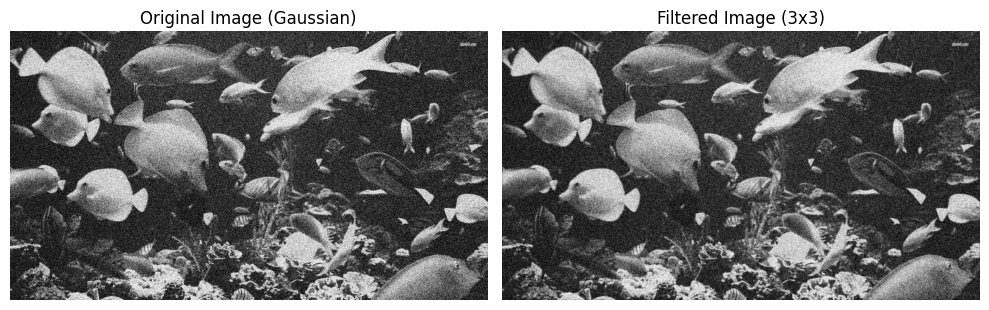

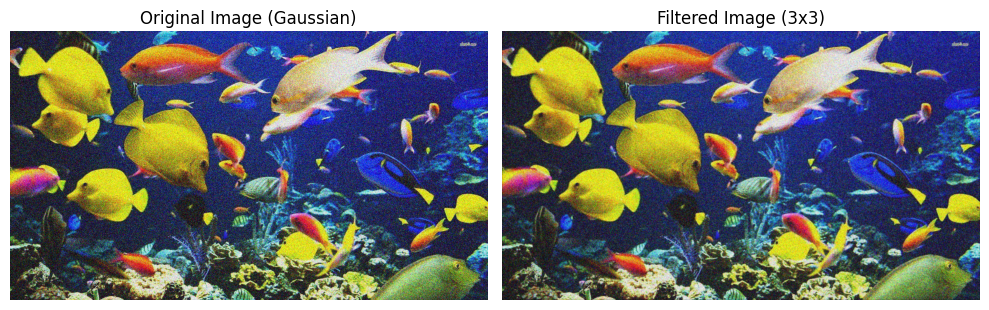

PSNR for Gaussian noise (Gray) with 3x3 kernel: 7.39
SSIM for Gaussian noise (Gray) with 3x3 kernel: 0.03
PSNR for Gaussian noise (Color) with 3x3 kernel: 7.03
SSIM for Gaussian noise (Color) with 3x3 kernel: 0.01


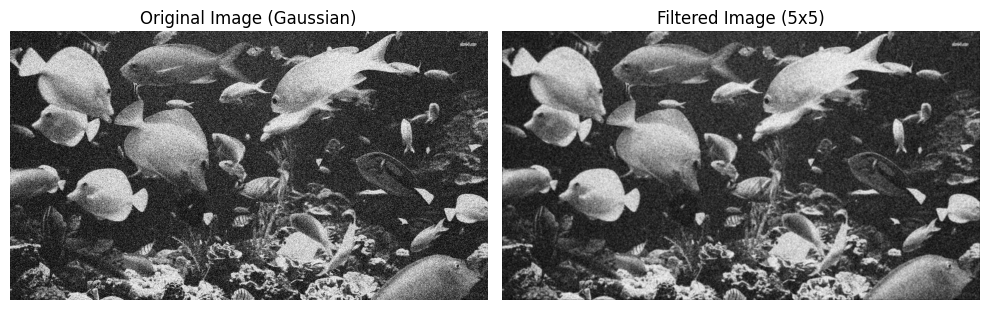

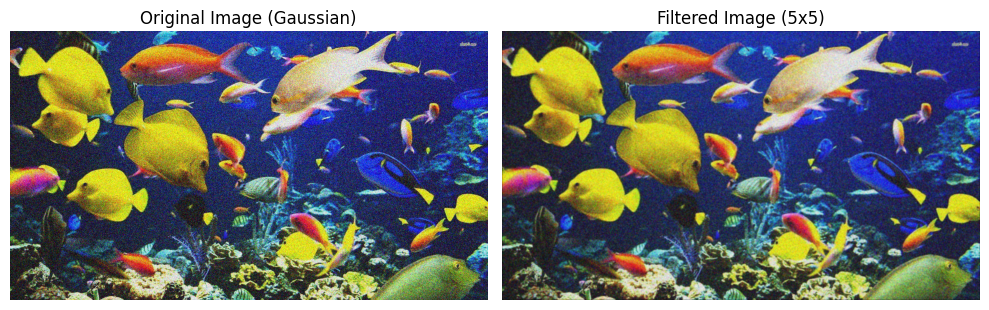

PSNR for Gaussian noise (Gray) with 5x5 kernel: 7.39
SSIM for Gaussian noise (Gray) with 5x5 kernel: 0.03
PSNR for Gaussian noise (Color) with 5x5 kernel: 7.03
SSIM for Gaussian noise (Color) with 5x5 kernel: 0.01


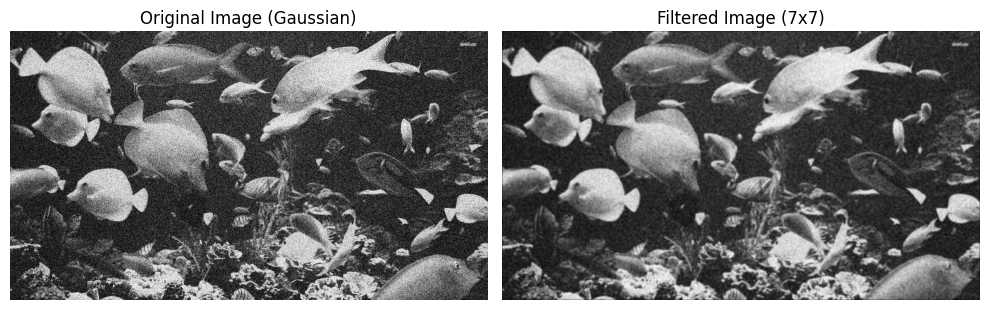

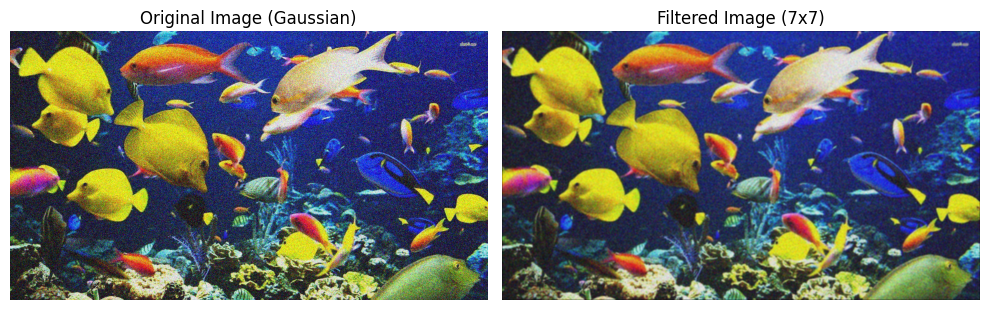

PSNR for Gaussian noise (Gray) with 7x7 kernel: 7.39
SSIM for Gaussian noise (Gray) with 7x7 kernel: 0.03
PSNR for Gaussian noise (Color) with 7x7 kernel: 7.03
SSIM for Gaussian noise (Color) with 7x7 kernel: 0.01


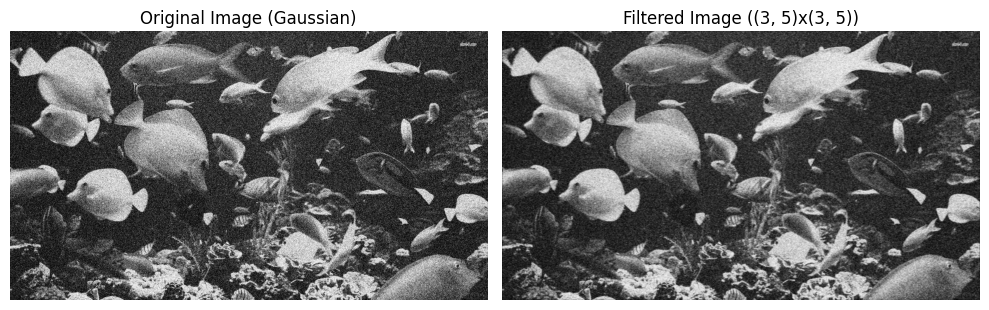

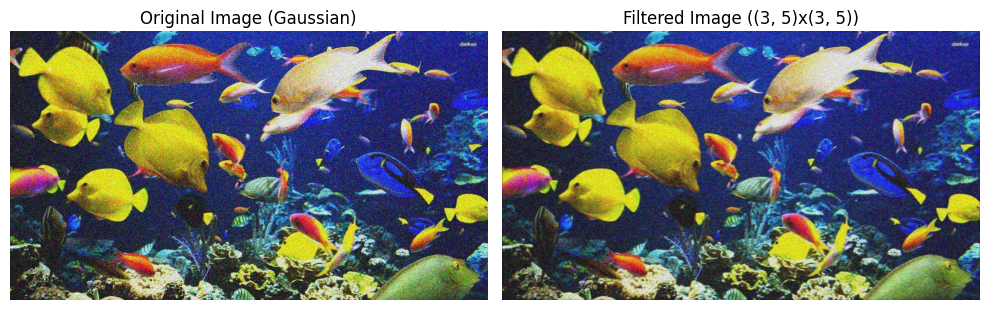

PSNR for Gaussian noise (Gray) with (3, 5)x(3, 5) kernel: 7.39
SSIM for Gaussian noise (Gray) with (3, 5)x(3, 5) kernel: 0.03
PSNR for Gaussian noise (Color) with (3, 5)x(3, 5) kernel: 7.03
SSIM for Gaussian noise (Color) with (3, 5)x(3, 5) kernel: 0.01


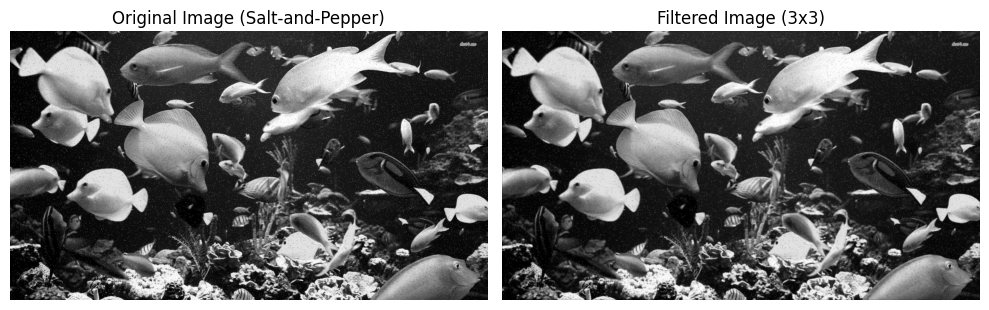

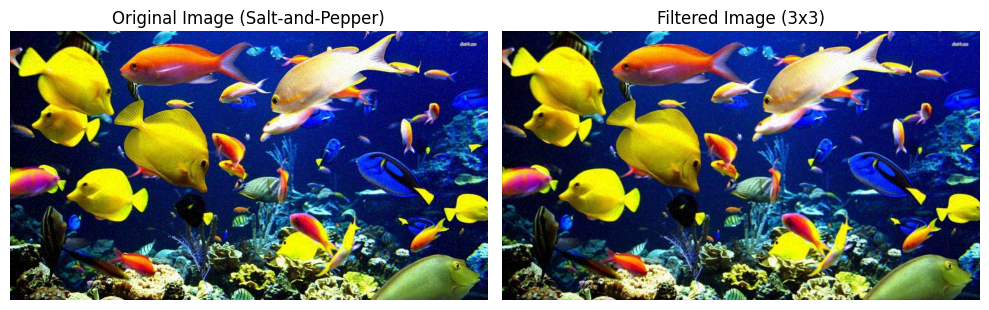

PSNR for Salt-and-Pepper noise (Gray) with 3x3 kernel: 7.39
SSIM for Salt-and-Pepper noise (Gray) with 3x3 kernel: 0.03
PSNR for Salt-and-Pepper noise (Color) with 3x3 kernel: 7.03
SSIM for Salt-and-Pepper noise (Color) with 3x3 kernel: 0.01


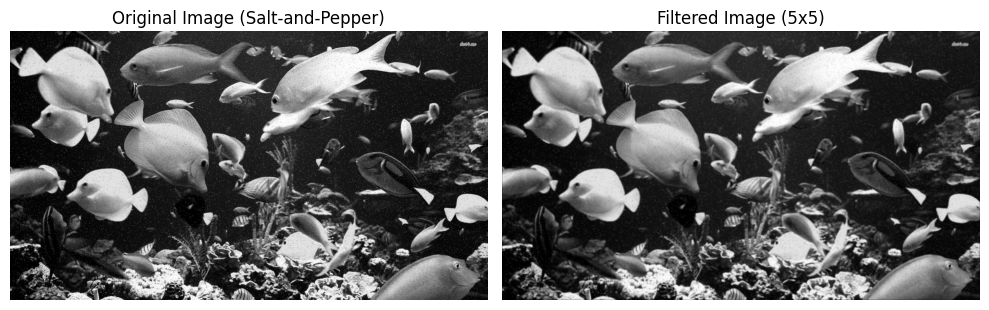

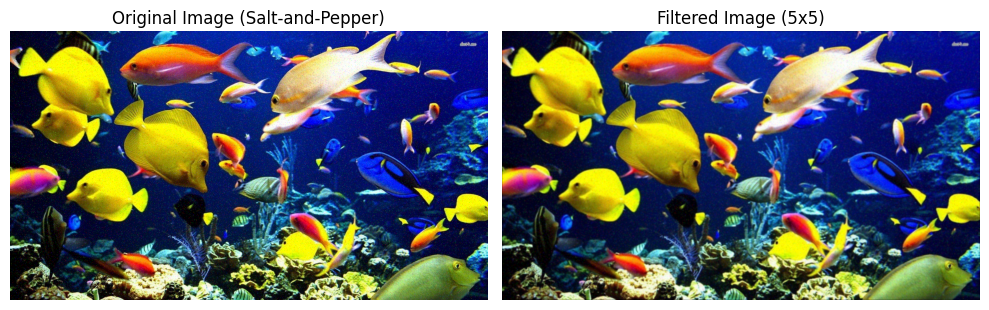

PSNR for Salt-and-Pepper noise (Gray) with 5x5 kernel: 7.39
SSIM for Salt-and-Pepper noise (Gray) with 5x5 kernel: 0.03
PSNR for Salt-and-Pepper noise (Color) with 5x5 kernel: 7.03
SSIM for Salt-and-Pepper noise (Color) with 5x5 kernel: 0.01


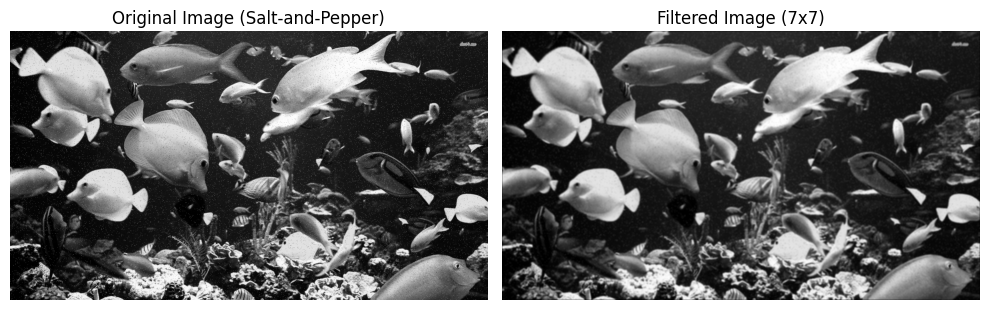

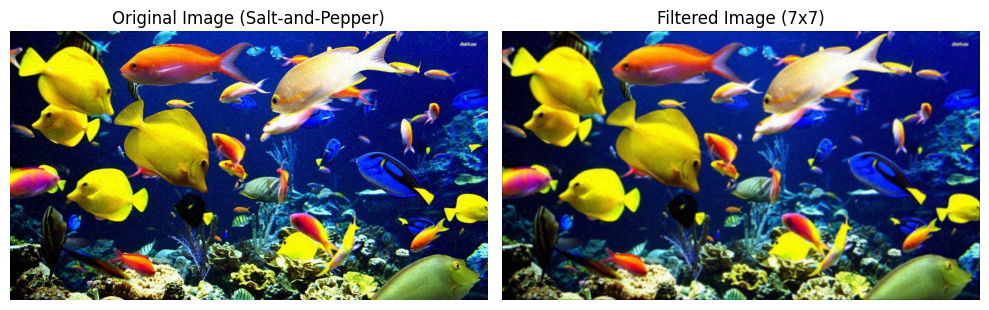

PSNR for Salt-and-Pepper noise (Gray) with 7x7 kernel: 7.39
SSIM for Salt-and-Pepper noise (Gray) with 7x7 kernel: 0.03
PSNR for Salt-and-Pepper noise (Color) with 7x7 kernel: 7.03
SSIM for Salt-and-Pepper noise (Color) with 7x7 kernel: 0.01


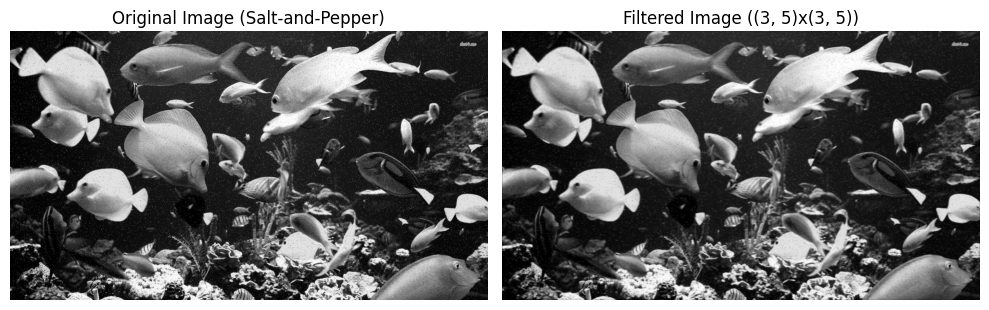

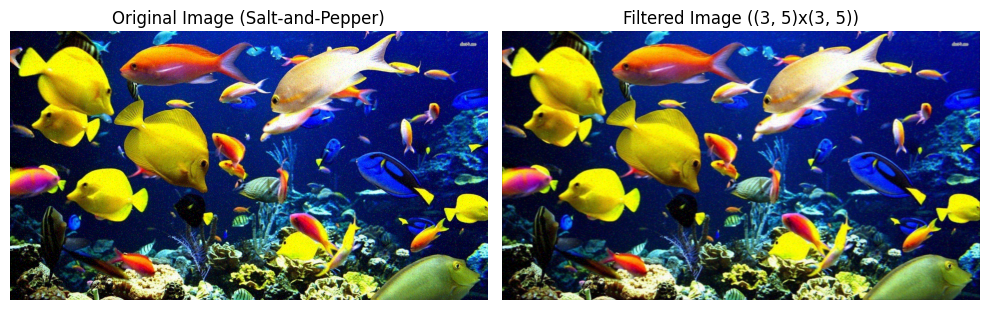

PSNR for Salt-and-Pepper noise (Gray) with (3, 5)x(3, 5) kernel: 7.39
SSIM for Salt-and-Pepper noise (Gray) with (3, 5)x(3, 5) kernel: 0.03
PSNR for Salt-and-Pepper noise (Color) with (3, 5)x(3, 5) kernel: 7.03
SSIM for Salt-and-Pepper noise (Color) with (3, 5)x(3, 5) kernel: 0.01


In [2]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from skimage.util import random_noise
from skimage.metrics import peak_signal_noise_ratio as psnr
from skimage.metrics import structural_similarity as ssim

# Load image
def load_image(image_path):
    img = Image.open(image_path).convert("RGB")
    gray_img = img.convert("L")  # Convert to grayscale
    return np.array(gray_img), np.array(img)

# Add Gaussian noise
def add_gaussian_noise(image, var=0.1):
    return random_noise(image, mode='gaussian', var=var)

# Add Salt-and-Pepper noise
def add_salt_and_pepper_noise(image, amount=0.02):
    return random_noise(image, mode='s&p', amount=amount)

# Apply moving average filter
def moving_average_filter(img, kernel_size):
    kernel = np.ones((kernel_size, kernel_size), dtype=np.float32) / (kernel_size * kernel_size)
    return convolve2d(img, kernel)

# 2D convolution function
def convolve2d(img, kernel):
    # Handle images with 3 channels (color)
    if len(img.shape) == 3:
        img_height, img_width, img_channels = img.shape
        pad_height = kernel.shape[0] // 2
        pad_width = kernel.shape[1] // 2
        padded_img = np.pad(img, ((pad_height, pad_height), (pad_width, pad_width), (0, 0)), mode='constant', constant_values=0)
        output = np.zeros_like(img)
        for i in range(img_height):
            for j in range(img_width):
                for k in range(img_channels):
                    region = padded_img[i:i + kernel.shape[0], j:j + kernel.shape[1], k]
                    output[i, j, k] = np.sum(region * kernel)
        return output
    else:  # Handle grayscale images
        kernel_height, kernel_width = kernel.shape
        img_height, img_width = img.shape
        pad_height = kernel_height // 2
        pad_width = kernel_width // 2

        padded_img = np.pad(img, ((pad_height, pad_height), (pad_width, pad_width)), mode='constant', constant_values=0)

        output = np.zeros_like(img)
        for i in range(img_height):
            for j in range(img_width):
                region = padded_img[i:i + kernel_height, j:j + kernel_width]
                output[i, j] = np.sum(region * kernel)

        return output

# Compute PSNR and SSIM
def compute_metrics(original, filtered):
    # Ensure the images are in the range [0, 255] for PSNR and SSIM
    original = np.clip(original, 0, 255).astype(np.uint8)
    filtered = np.clip(filtered, 0, 255).astype(np.uint8)

    psnr_value = psnr(original, filtered, data_range=255)
    # Explicitly set win_size to a smaller odd value like 3
    ssim_value = ssim(original, filtered, data_range=255, multichannel=True, win_size=3) if len(original.shape) == 3 else ssim(original, filtered, data_range=255, win_size=3)
    return psnr_value, ssim_value

# Display images
def display_images(original, filtered, kernel_size, noise_type):
    plt.figure(figsize=(10, 5))

    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title(f"Original Image ({noise_type})")
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(filtered, cmap='gray')
    plt.title(f"Filtered Image ({kernel_size}x{kernel_size})")
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Main processing
image_path = 'fish.jpg'  # Replace with your image path
gray_img, color_img = load_image(image_path)

# Add Gaussian and Salt-and-Pepper noise
gaussian_noisy_gray = add_gaussian_noise(gray_img)
salt_pepper_noisy_gray = add_salt_and_pepper_noise(gray_img)

gaussian_noisy_color = add_gaussian_noise(color_img)
salt_pepper_noisy_color = add_salt_and_pepper_noise(color_img)

# Kernel sizes to test
kernel_sizes = [3, 5, 7, (3, 5)]

# Process each noise type and kernel size for grayscale and color images
for noise_type, noisy_gray, noisy_color in [
    ('Gaussian', gaussian_noisy_gray, gaussian_noisy_color),
    ('Salt-and-Pepper', salt_pepper_noisy_gray, salt_pepper_noisy_color)
]:
    for kernel_size in kernel_sizes:
        if isinstance(kernel_size, tuple):  # Non-square kernel (3x5)
            filtered_gray = convolve2d(noisy_gray, np.ones(kernel_size, np.float32) / np.prod(kernel_size))
            filtered_color = convolve2d(noisy_color, np.ones(kernel_size, np.float32) / np.prod(kernel_size))
        else:  # Square kernel (e.g., 3x3, 5x5, 7x7)
            filtered_gray = moving_average_filter(noisy_gray, kernel_size)
            filtered_color = moving_average_filter(noisy_color, kernel_size)

        # Display the images
        display_images(noisy_gray, filtered_gray, kernel_size, noise_type)
        display_images(noisy_color, filtered_color, kernel_size, noise_type)

        # Compute and print PSNR and SSIM
        psnr_gray, ssim_gray = compute_metrics(gray_img, filtered_gray)
        psnr_color, ssim_color = compute_metrics(color_img, filtered_color)
        print(f'PSNR for {noise_type} noise (Gray) with {kernel_size}x{kernel_size} kernel: {psnr_gray:.2f}')
        print(f'SSIM for {noise_type} noise (Gray) with {kernel_size}x{kernel_size} kernel: {ssim_gray:.2f}')
        print(f'PSNR for {noise_type} noise (Color) with {kernel_size}x{kernel_size} kernel: {psnr_color:.2f}')
        print(f'SSIM for {noise_type} noise (Color) with {kernel_size}x{kernel_size} kernel: {ssim_color:.2f}')


QUESTION 1 B): WITH COLOR AND GRAYSCALE IMAGE

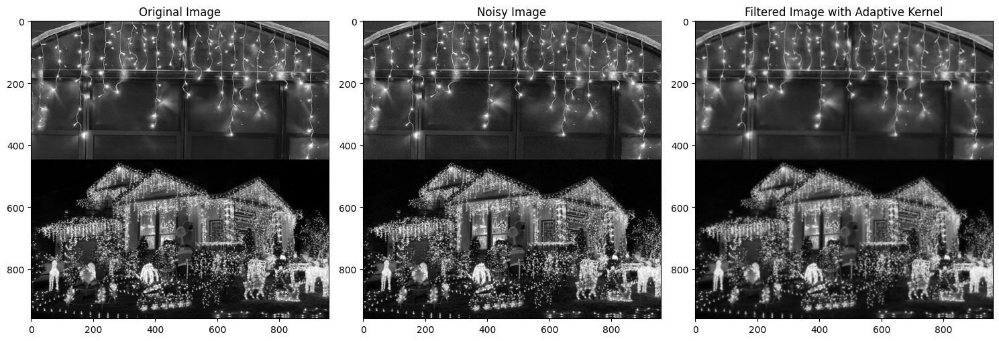

In [3]:
import numpy as np
from PIL import Image
import random
import matplotlib.pyplot as plt

# Load a grayscale image
def load_grayscale_image(image_path):
    img = Image.open(image_path).convert("L")  # Convert to grayscale
    return img

# Add Gaussian noise
def add_gaussian_noise(img, mean=0, var=50):
    noisy_img = img.copy()
    pixels = noisy_img.load()
    for i in range(noisy_img.width):
        for j in range(noisy_img.height):
            noise = int(random.gauss(mean, var**0.5))
            new_value = max(0, min(255, pixels[i, j] + noise))  # Clamp to 0-255
            pixels[i, j] = new_value
    return noisy_img

# Calculate local variance for a given window
def calculate_local_variance(img, window_size=3):
    width, height = img.size
    variance_image = Image.new("L", (width, height))
    pixels = variance_image.load()

    # Loop through image excluding borders
    for i in range(window_size // 2, width - window_size // 2):
        for j in range(window_size // 2, height - window_size // 2):
            window = [img.getpixel((x, y)) for x in range(i - window_size // 2, i + window_size // 2 + 1)
                      for y in range(j - window_size // 2, j + window_size // 2 + 1)]
            mean = np.mean(window)
            variance = np.var(window)
            pixels[i, j] = int(variance)  # Store variance value

    return variance_image

# Apply adaptive moving average filter
def apply_adaptive_moving_average_filter(img, variance_image, low_threshold=50, high_threshold=200, max_kernel_size=9):
    width, height = img.size
    output_image = img.copy()
    pixels = output_image.load()

    # Loop through each pixel to apply the filter, avoiding the edge pixels
    for i in range(1, width - 1):  # Avoid the edge pixels
        for j in range(1, height - 1):  # Avoid the edge pixels
            variance = variance_image.getpixel((i, j))

            # Define the kernel size based on the local variance
            if variance < low_threshold:
                kernel_size = max_kernel_size  # Larger kernel for smooth regions
            elif variance > high_threshold:
                kernel_size = 3  # Smaller kernel for high variance (edges)
            else:
                kernel_size = 5  # Medium-sized kernel for moderate variance

            # Ensure kernel size is valid, especially near image edges
            kernel_size = min(kernel_size, min(i, width - i - 1, j, height - j - 1) * 2 + 1)

            # Apply the moving average filter with the selected kernel size
            window = [img.getpixel((x, y)) for x in range(i - kernel_size // 2, i + kernel_size // 2 + 1)
                      for y in range(j - kernel_size // 2, j + kernel_size // 2 + 1)]
            mean = np.mean(window)
            pixels[i, j] = int(mean)  # Set the new pixel value as the mean of the window

    return output_image

# Load the image and add Gaussian noise
image_path = "lights.jpg"  # Replace with your grayscale image path
image = load_grayscale_image(image_path)
noisy_image = add_gaussian_noise(image)

# Calculate local variance for the noisy image
variance_image = calculate_local_variance(noisy_image)

# Apply the adaptive moving average filter
filtered_image = apply_adaptive_moving_average_filter(noisy_image, variance_image)

# Display the original, noisy, and filtered images
plt.figure(figsize=(15, 10))

plt.subplot(1, 3, 1)
plt.imshow(image, cmap="gray")
plt.title("Original Image")

plt.subplot(1, 3, 2)
plt.imshow(noisy_image, cmap="gray")
plt.title("Noisy Image")

plt.subplot(1, 3, 3)
plt.imshow(filtered_image, cmap="gray")
plt.title("Filtered Image with Adaptive Kernel")

plt.tight_layout()
plt.show()


QUESTION 2

With OpenCV

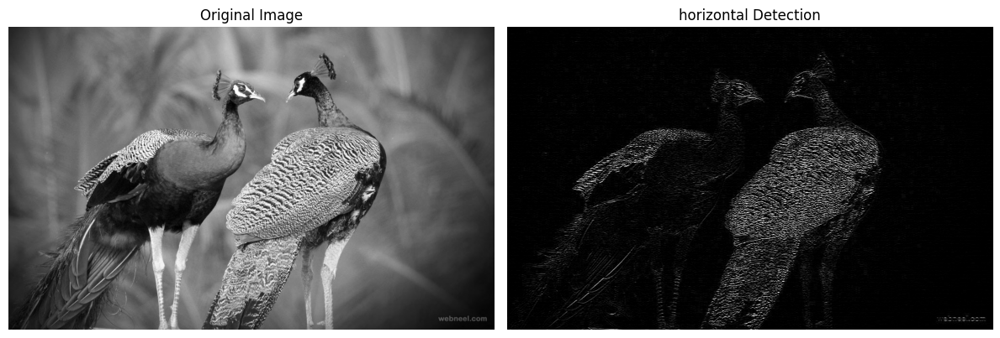

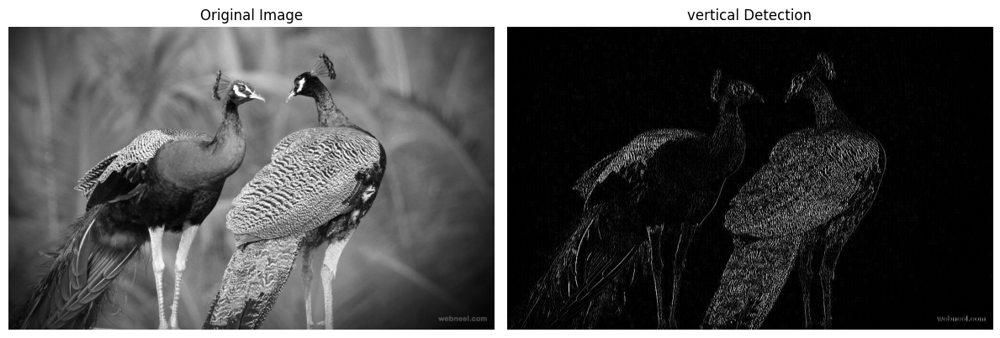

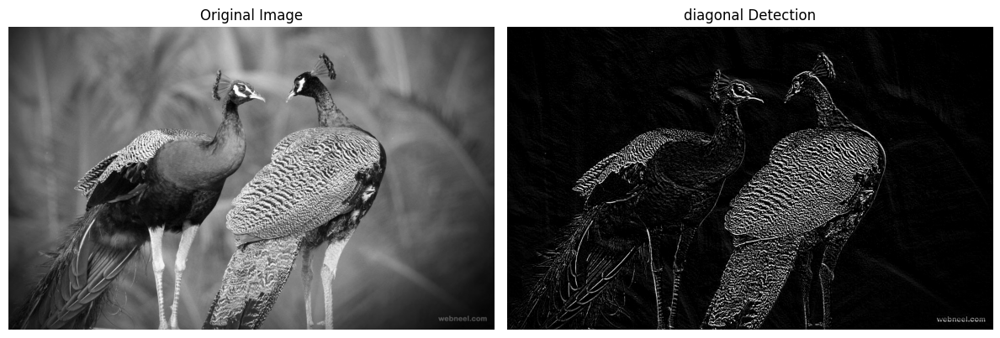

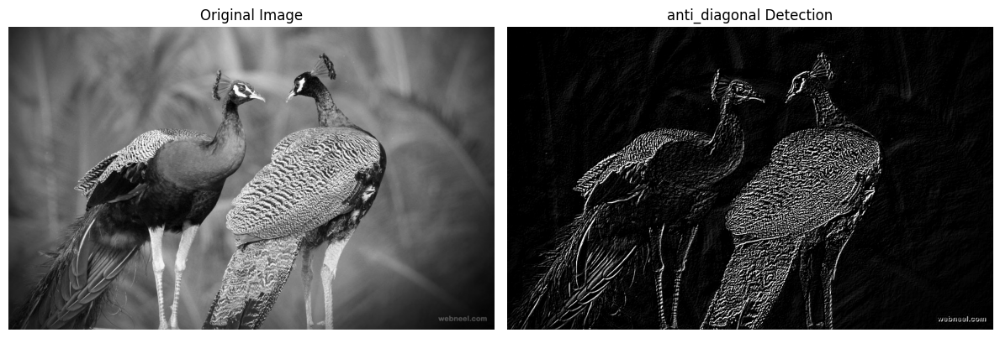

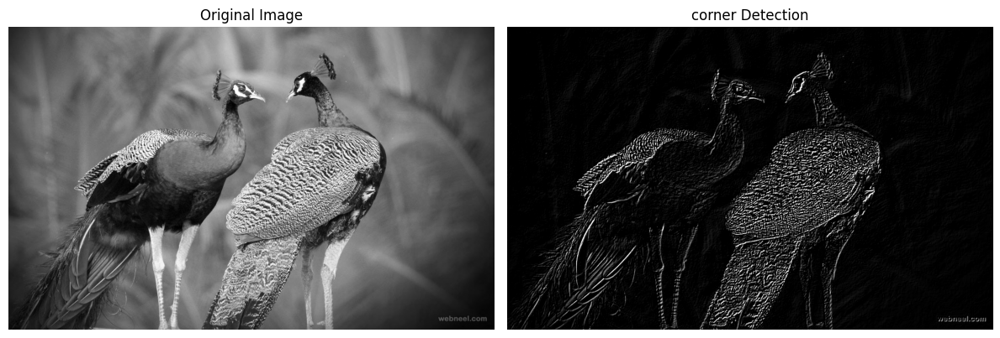

In [4]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

# Load the image
def load_image(image_path):
    img = cv2.imread(image_path)
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return img, gray_img

# Custom convolution kernels
kernels = {
    'horizontal': np.array([[-1, -1, -1],
                            [ 2,  2,  2],
                            [-1, -1, -1]]),
    'vertical': np.array([[-1,  2, -1],
                          [-1,  2, -1],
                          [-1,  2, -1]]),
    'diagonal': np.array([[-1,  2,  2],
                          [-1,  2, -1],
                          [-1, -1, -1]]),
    'anti_diagonal': np.array([[ 2,  2, -1],
                               [ 2, -1, -1],
                               [-1, -1, -1]]),
    'corner': np.array([[1, 1, 0],
                        [1, 0, -1],
                        [0, -1, -1]])
}

# Apply convolution using OpenCV filter2D
def apply_filter(image, kernel):
    return cv2.filter2D(image, -1, kernel)

# Display images
def display_images(original, filtered, title='Filtered Image'):
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(filtered, cmap='gray')
    plt.title(title)
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Main
image_path = 'peacock.jpg'
img, gray_img = load_image(image_path)

# Apply kernels and visualize the results
for name, kernel in kernels.items():
    filtered_img = apply_filter(gray_img, kernel)
    display_images(gray_img, filtered_img, title=f'{name} Detection')



Without OpenCV

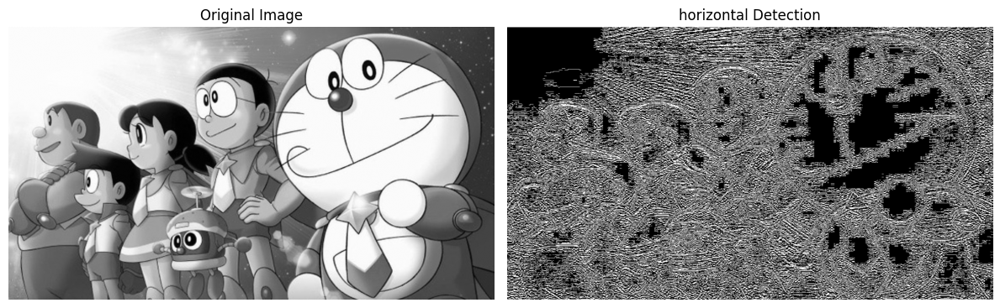

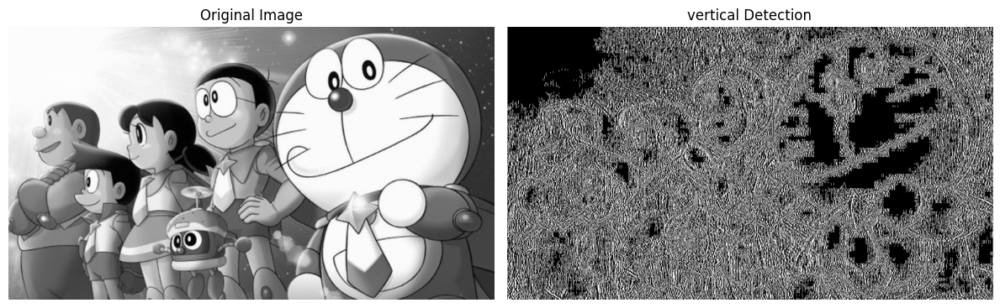

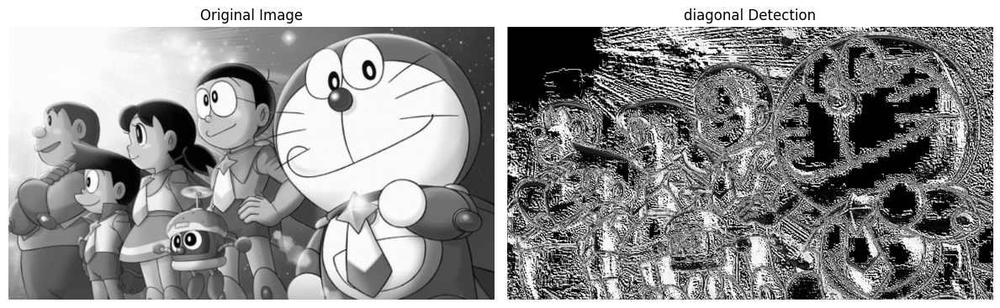

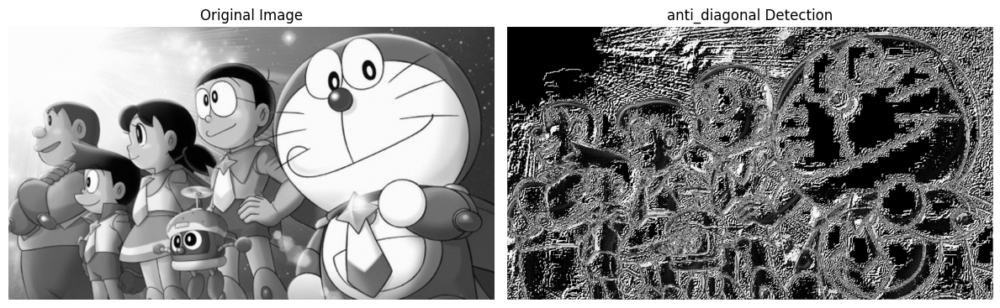

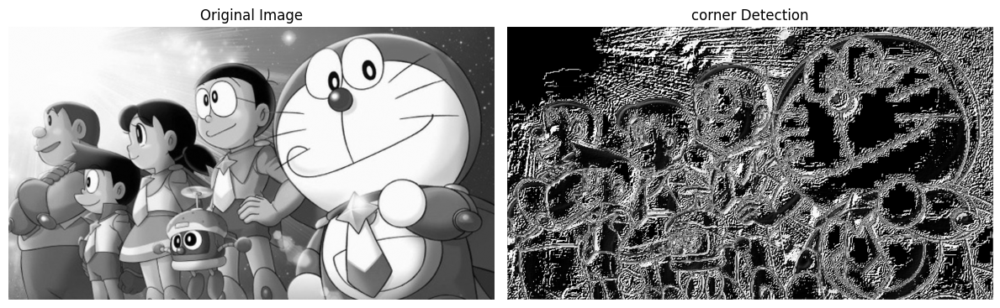

In [5]:
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image

# Load image
def load_image(image_path):
    img = Image.open(image_path).convert("RGB")
    gray_img = img.convert("L")  # Convert to grayscale
    return np.array(gray_img)

# Custom convolution kernels
kernels = {
    'horizontal': np.array([[-1, -1, -1],
                            [ 2,  2,  2],
                            [-1, -1, -1]]),
    'vertical': np.array([[-1,  2, -1],
                          [-1,  2, -1],
                          [-1,  2, -1]]),
    'diagonal': np.array([[-1,  2,  2],
                          [-1,  2, -1],
                          [-1, -1, -1]]),
    'anti_diagonal': np.array([[ 2,  2, -1],
                               [ 2, -1, -1],
                               [-1, -1, -1]]),
    'corner': np.array([[1, 1, 0],
                        [1, 0, -1],
                        [0, -1, -1]])
}

# 2D Convolution function
def convolve2d(img, kernel):
    kernel_height, kernel_width = kernel.shape
    img_height, img_width = img.shape
    pad_height = kernel_height // 2
    pad_width = kernel_width // 2

    padded_img = np.pad(img, ((pad_height, pad_height), (pad_width, pad_width)), mode='constant', constant_values=0)

    output = np.zeros_like(img)
    for i in range(img_height):
        for j in range(img_width):
            region = padded_img[i:i + kernel_height, j:j + kernel_width]
            output[i, j] = np.sum(region * kernel)

    return output

# Display images
def display_images(original, filtered, title='Filtered Image'):
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.imshow(original, cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(filtered, cmap='gray')
    plt.title(title)
    plt.axis('off')

    plt.tight_layout()
    plt.show()

# Main
image_path = 'image.jpg'  # Replace with your image path
gray_img = load_image(image_path)

# Apply kernels and visualize the results
for name, kernel in kernels.items():
    filtered_img = convolve2d(gray_img, kernel)
    display_images(gray_img, filtered_img, title=f'{name} Detection')

